<a href="https://colab.research.google.com/github/smerner/cs166/blob/master/politicalint_cynicism.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [0]:
import matplotlib.pyplot as plt
%matplotlib inline
import networkx as nx
import numpy as np
import random
from scipy import stats

In [0]:
class CynicismLevel:

  '''
Simulate voter turnout based on levels of political interest in 
nodes and spread of cynicism in random interaction between nodes 
  '''
  def __init__(self, network_size=50, cynicism_threshold = 0.2, 
               pol_int_threshold = 0.7, education_prob = 0.2, markup = True):
    
    '''
        Inputs:
            
            network_size (int) - number of nodes in random Watts-Strogatz 
            small-world network. Default: 50. 
           
            self.cynicism_threshold (int) - if one node has cynicism higher 
            than this threshold they will they will aim to spread cynicism to 
            the other node. Default: 0.2 
            
            pol_int_threshold (int) - if one node has political interest that
            is lower than this given threshold they will be more suceptible to 
            the spread of cynicism from the other node. Default: 0.7 
            
            education_prob (int) - probability of randomly being assigned the educaiton intervention (which increases political interest)
            
            
   ''' 
    self.network_size = network_size
    self.cynicism_threshold = cynicism_threshold
    self.pol_int_threshold = pol_int_threshold
    self.education_prob = education_prob
    self.step = 0 
    
    # the arrays will store variables of each step
    self.cynicicm_step_nodes = []
    self.political_interest_step_nodes = []
    self.cynicism_change = []
    self.political_interest_change = []
    
    # the arrays that will store the variables average all steps 
    self.global_avg_pol_int = []
    self.global_avg_cynicism = []
    self.markup= markup
    # measuring the changes in cynicism & political interest 
        
    
  def initialize(self):
    '''
    Initialization of the network using the Watts Strogatz Graph  
    
    '''
    
    #initialize the network 
    self.graph = nx.watts_strogatz_graph(self.network_size,5, 0.5)
    #self.graph = nx.barabasi_albert_graph(50,5,0.5)
    
    # initialize all the nodes in the graph 
    for node in self.graph.nodes: # for all the nodes 
      # sets level of political interest, cynicism and openmindedness at random float between 0.0 and 1.0
      self.graph.nodes[node]['political_interest'] = random.random()
      self.graph.node[node]['cynicism'] = random.random()
      self.graph.node[node]['openmindedness'] = random.random()
      
    # initialize the edges with the same weights 
    for edge in self.graph.edges: # all the edges in the graph 
      self.graph.edges[edge]['weight'] = 0.5
    
    self.layout = nx.spring_layout(self.graph) # visual layout 

  def observe(self):

    '''
    visualize the network 
    ''' 
    
    self.layout = nx.spring_layout(self.graph, pos = self.layout, k = 0.7, iterations=50)
    plt.clf()
    nx.draw(
        self.graph, pos=self.layout, with_labels=True,
        
        # colors in the nodes represent the resulting cynicism from the random interaction 
        node_color=[self.graph.nodes[i]['cynicism'] for i in self.graph.nodes], 
        cmap=plt.cm.RdYlGn,
     
        # the size of the node represent the political interest level of the nodes 
        node_size=[self.graph.nodes[i]['political_interest']*1000 for i in self.graph.nodes],  
        edge_color=[self.graph.edges[i, j]['weight'] for i, j in self.graph.edges],         
        edge_cmap= plt.cm.binary, edge_vmin=0, 
        edge_vmax=1, vmin=0, alpha=0.7, vmax=1)
    
    #self.global_avg_pol_int.append(np.mean(self.step_mean_political_interest))
    #self.global_avg_cynicism.append(np.mean(self.step_mean_cynicism))
 
    plt.title('Step: ' + str(self.step)+ ' Average Political Interest:  ' + str(np.mean(self.political_interest_step_nodes)) + ' Average Cynicism:  ' + str(np.mean(self.cynicicm_step_nodes)))  
    
  def print_results(self):
    
    fig, axs = plt.subplots(2, 1, sharex=True)
    '''
    Graph of the change in cynicism level and political interest level over time 
    
    '''
    
    plt.subplots_adjust(bottom=.5,top=2, hspace=.1)
    axs[0].plot(self.global_avg_cynicism)
    axs[0].set(title = 'Change in average Cynicism over time',ylabel ='Cynicism')

    axs[1].plot(self.global_avg_pol_int, color='red') 
    axs[1].set(ylabel = 'Change in Political Interest over time')

    plt.show()
  
  def conversation(self):
         
        
        # random occurence  1% of the time
        if random.uniform(0, 1) < 0.01:
            
            # create a new edge with weight 0.5 between two unconnected nodes
            nodes = list(self.graph.nodes)
            while True:
                # make a new edge 
                new_edge = random.sample(nodes, 2)
                if new_edge not in self.graph.edges:
                    break
            self.graph.add_edge(new_edge[0], new_edge[1], weight=0.5)
        
        # the other 99% of the time
        else:  
            # out of all possible nodes in the graph 
            nodes = list(self.graph.nodes) 
            
            # randomly choose a node 
            node_1 = np.random.choice(nodes) 
            
            # randomly choose a neighboring node 
            node_2 = np.random.choice(list(self.graph.neighbors(node_1)))
            
            cynicism_1 = self.graph.nodes[node_1]['cynicism']
            cynicism_2 = self.graph.node[node_2]['cynicism']
            political_interest_1 = self.graph.node[node_1]['political_interest'] 
            political_interest_2 = self.graph.nodes[node_2]['political_interest'] 
            open_mind_1 = self.graph.node[node_1]['openmindedness']
            open_mind_2 = self.graph.node[node_2]['openmindedness']
            
            edge = (node_1, node_2)
            weight = self.graph.edges[edge]['weight']
            
            if cynicism_1 > self.cynicism_threshold:
              if political_interest_2 < self.pol_int_threshold:
                if cynicism_1 > cynicism_2:               
                  self.graph.nodes[node_2]['cynicism'] = cynicism_1                                
                
                
            # Randomized Education Intervention - randomly updating political interest (to show education initiative)              
          
            for x in self.graph.nodes(): # for all the nodes  
              # for those under 0.5 level of political interest 
              if self.graph.node[x]['political_interest']  < 0.5: 
                # there is a probability of getting this education initiative 
                if np.random.uniform(0, 1) < self.education_prob: 
                  self.graph.node[x]['political_interest']  += 0.1 # increased level of political interest  
            
              
            if self.graph.edges[edge]['weight'] < 0.1:
              self.graph.remove_edge(*edge)
                          
            
            self.step += 1 
            #accessing the node attributes 
            cynicism = nx.get_node_attributes(self.graph,'cynicism')            
            political_interest = nx.get_node_attributes(self.graph,'political_interest')
            
            # creating a list of node values 
            self.cynicicm_step_nodes = list(cynicism.values())
            self.political_interest_step_nodes = list(political_interest.values()) # all nodes of one step
            
            
            # changes in cynicism and political interest of each agent 
            diff_pol = abs(self.political_interest_step_nodes[-1] - self.political_interest_step_nodes[0])
            self.political_interest_change.append(diff_pol)
            
            diff_cyn = abs(self.cynicicm_step_nodes[-1] - self.cynicicm_step_nodes[0])
            self.cynicism_change.append(diff_cyn)
            
            
            # the arrays that will store the variables average all steps 
            self.global_avg_pol_int.append(np.mean(self.political_interest_step_nodes))
            self.global_avg_cynicism.append(np.mean(self.cynicicm_step_nodes)) 
   
              
  def simulate(self, trials):
    self.initialize()
    for i in range(150):
      if self.markup:
        self.print_results()
      
      for j in range(10):
        self.observe()
        self.conversation()
 


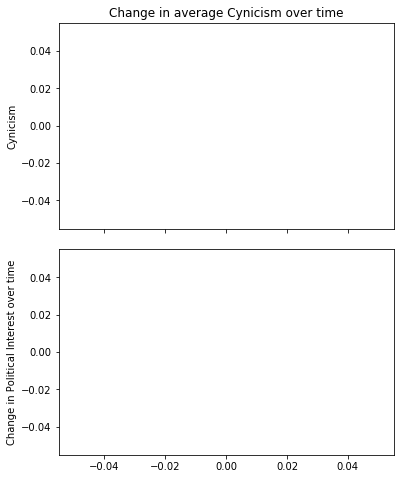

/usr/local/lib/python3.6/dist-packages/numpy/core/fromnumeric.py:3118: RuntimeWarning: Mean of empty slice.
  out=out, **kwargs)
/usr/local/lib/python3.6/dist-packages/numpy/core/_methods.py:85: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


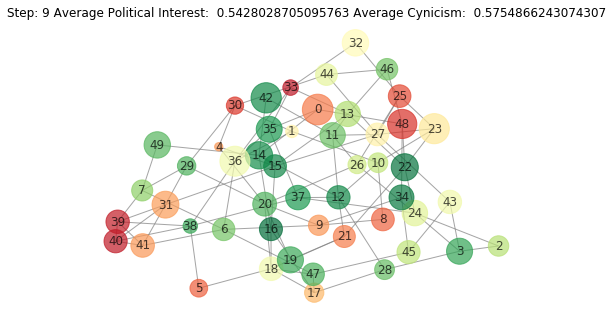

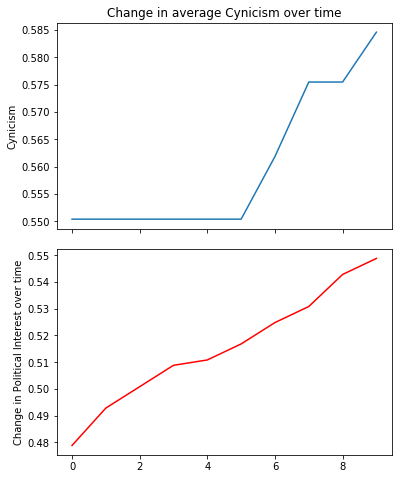

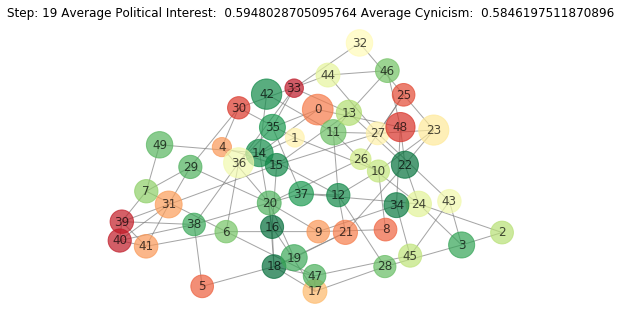

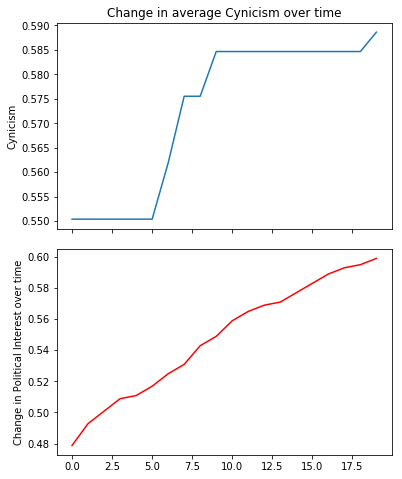

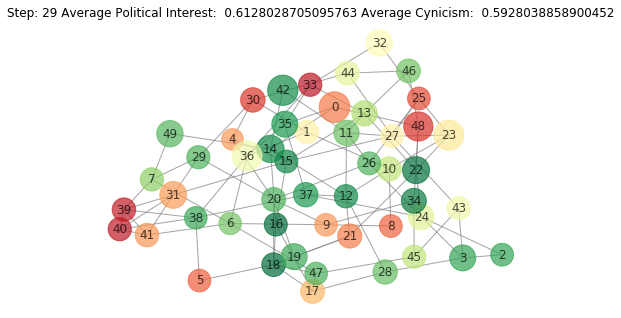

...

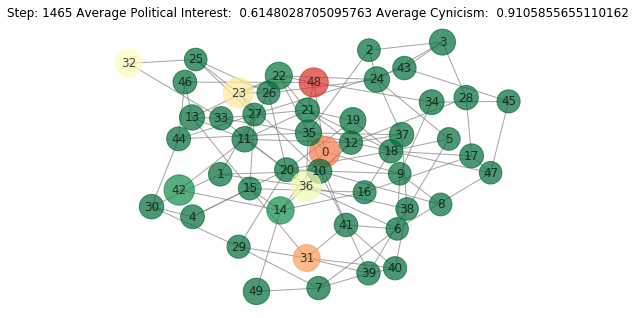

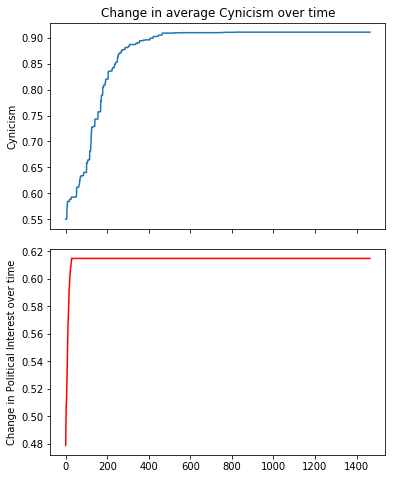

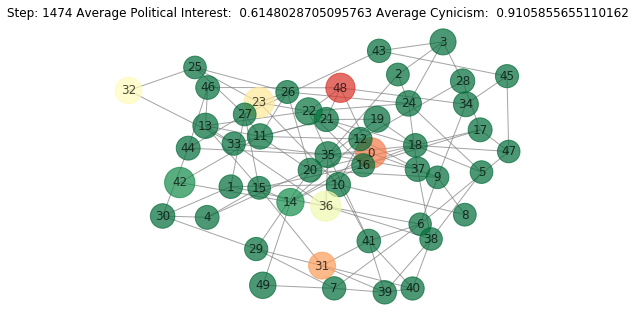

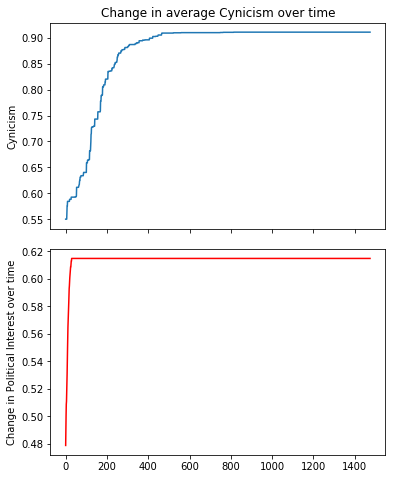

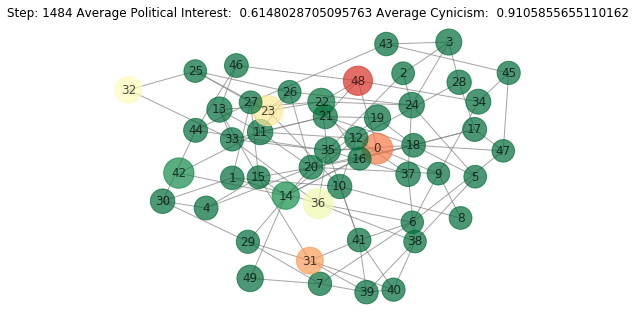

In [0]:
#simulating the #simulating the spread of cynicism t = 1000

sim = CynicismLevel(markup=True)
sim.simulate(10)

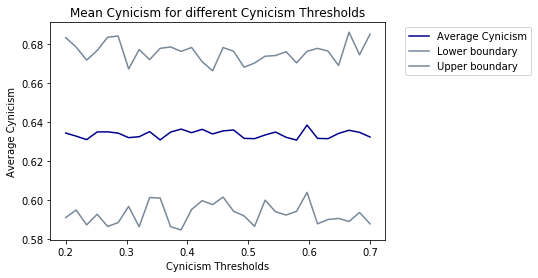

[0.6345897294539763, 0.6329830810085432, 0.631210424538291, 0.6351328967701304, 0.635187917991257, 0.6345467958802907, 0.6322143138056161, 0.6326857812884841, 0.6353090231058074, 0.6310603381982276, 0.635070333772396, 0.6366034039554013, 0.634757563689076, 0.6364855800972677, 0.634126670745314, 0.6356800531602298, 0.636145032976977, 0.6318502035804154, 0.6316933243488758, 0.6335883019585988, 0.6350806418047669, 0.6324030649674633, 0.6309603646972233, 0.6386647954043947, 0.6318286311237097, 0.6317022954152929, 0.6343798250951973, 0.6360015436888868, 0.634948484925068, 0.6325383291272931]


In [0]:
# impact of different cynicism threshold on average cynicism  
cynicism_thresholds = np.linspace(0.2, 0.7, 30)
av_cynicism = []
trials = 100 
n_simulations = 100

arr_mean = []
arr_lb = []
arr_ub = []

for c in cynicism_thresholds:
  arr_results=[]
  for _ in range(n_simulations):
    sim = CynicismLevel(cynicism_threshold = c)
    sim.initialize()
    for _ in range(trials):
      sim.conversation()
    arr_results.append(np.mean(sim.global_avg_cynicism)) 
  arr_mean.append(np.mean(arr_results))
  arr_lb.append(np.percentile(arr_results, 2.7))
  arr_ub.append(np.percentile(arr_results, 97.5))

plt.plot(cynicism_thresholds, arr_mean, label = 'Average Cynicism', color = 'darkblue')
plt.plot(cynicism_thresholds, arr_lb, label = 'Lower boundary', color='lightslategray' )
plt.plot(cynicism_thresholds, arr_ub, label = 'Upper boundary',color='lightslategray')
plt.title('Mean Cynicism for different Cynicism Thresholds') 
plt.xlabel('Cynicism Thresholds')
plt.ylabel('Average Cynicism')
plt.legend(loc=1, bbox_to_anchor=(1.45, 1))
plt.show()


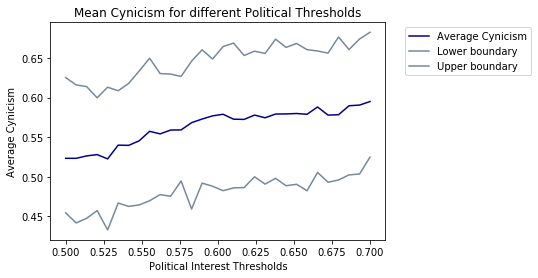

[0.5233070878582167, 0.5232836494685569, 0.5263432141943514, 0.5279919479810183, 0.5225722631911391, 0.5399398608866632, 0.5396347972949099, 0.5453949213846992, 0.5574030559694652, 0.5541564577894991, 0.558968290413765, 0.5591768919910113, 0.5683211023527112, 0.5728911543086996, 0.5769029417675186, 0.5789163279043253, 0.5727014979502854, 0.5724233410075238, 0.57789071261796, 0.5744898610066782, 0.579194377425993, 0.5793324560267813, 0.5798802623643412, 0.5789008582396498, 0.5881287283075136, 0.5778447789864815, 0.5783491890342384, 0.589654322953985, 0.5905076098111952, 0.5949895403405441]


In [0]:
# the impact of different political threshold on average cynicism 
political_thresholds = np.linspace(0.5, 0.7, 30)
av_pol_int = []
trials = 100 
n_simulations = 100

arr_mean = []
arr_lb = []
arr_ub = []

for p in political_thresholds:
  arr_results=[]
  for _ in range(n_simulations):
    sim = CynicismLevel(pol_int_threshold = p)
    sim.initialize()
    for _ in range(trials):
      sim.conversation()
    arr_results.append(np.mean(sim.global_avg_cynicism)) 
  arr_mean.append(np.mean(arr_results))
  arr_lb.append(np.percentile(arr_results, 2.7))
  arr_ub.append(np.percentile(arr_results, 97.5))

plt.plot(political_thresholds, arr_mean, label = 'Average Cynicism', color = 'darkblue')
plt.plot(political_thresholds, arr_lb, label = 'Lower boundary', color='lightslategray' )
plt.plot(political_thresholds, arr_ub, label = 'Upper boundary',color='lightslategray')
plt.title('Mean Cynicism for different Political Thresholds')  
plt.xlabel('Political Interest Thresholds')
plt.ylabel('Average Cynicism')
plt.legend(loc=1, bbox_to_anchor=(1.45, 1))
plt.show()
